#### add nan for all days not sampled

In [1]:
import pandas as pd
import numpy as np
from sys import platform
import datetime
from statsmodels.graphics.tsaplots import plot_acf
from statsmodels.graphics.tsaplots import plot_pacf

In [2]:
if platform == "linux" or platform == "linux2":
    data_string = "/home/maria/Documents/data/pied_piper/"
    output_string = "/home/maria/Documents/output/pied_piper/dungeness/"
else:
    data_string = "C:/Users/maria/OneDrive/Documents/data/pied_piper/"
    output_string = "C:/Users/maria/OneDrive/Documents/output/pied_piper/dungeness/"
        

In [3]:
df = pd.read_csv(data_string + "dungeness_2005-2020_combine_ma_msd_atu_photoperiod.csv", header = 0)
with pd.option_context('display.max_rows', None, 'display.max_columns', None):
    display(df)

,Unnamed: 0,Unnamed: 0_x,Unnamed: 0.1,Date,In,chinook0_hatchery_perhour,chinook0_wild_perhour,chinook0_hatchery_num,chinook0_wild_num,chinook1_hatchery_perhour,chinook1_wild_perhour,chinook1_hatchery_num,chinook1_wild_num,coho1_hatchery_perhour,coho1_wild_perhour,coho1_hatchery_num,coho1_wild_num,steelheadsmolt_hatchery_perhour,steelheadsmolt_wild_perhour,steelheadsmolt_hatchery_num,steelheadsmolt_wild_num,pink0_hatchery_perhour,pink0_wild_perhour,pink0_hatchery_num,pink0_wild_num,chum0_wild_perhour,chum0_wild_num,flow,temp,doy,year,ma_chinook0_wild_perhour,msd_chinook0_wild_perhour,ma_chinook1_wild_perhour,msd_chinook1_wild_perhour,ma_coho1_wild_perhour,msd_coho1_wild_perhour,ma_steelheadsmolt_wild_perhour,msd_steelheadsmolt_wild_perhour,ma_chum0_wild_perhour,msd_chum0_wild_perhour,ma_pink0_wild_perhour,msd_pink0_wild_perhour,ma_temp,ma_flow,chinook0_wild_perhour_mean,chinook1_wild_perhour_mean,coho1_wild_perhour_mean,steelheadsmolt_wild_perhour_mean,chum0_wild_perhour_mean,pink0_wild_perhour_mean,temp_mean,flow_mean,ma_chinook0_wild_perhour_mean,msd_chinook0_wild_perhour_mean,ma_chinook1_wild_perhour_mean,msd_chinook1_wild_perhour_mean,ma_coho1_wild_perhour_mean,msd_coho1_wild_perhour_mean,ma_steelheadsmolt_wild_perhour_mean,msd_steelheadsmolt_wild_perhour_mean,ma_chum0_wild_perhour_mean,msd_chum0_wild_perhour_mean,ma_pink0_wild_perhour_mean,msd_pink0_wild_perhour_mean,ma_temp_mean,ma_flow_mean,temp_y,atu_solstice,temp_z,atu_april,Unnamed: 0_y,photoperiod
0,0,0,0,2005-03-08,19.733333,0.000000,4.358108,0.0,86.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,5.371622,0.0,106.0,13.581081,268.0,154.000000,7.000000,67,2005,6.427303,4.216610e+00,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,70.129497,5.579530e+01,9.331162e+00,8.849078e+00,7.333333,169.416667,2.292856,0.000000,0.040055,0.004310,5.616000,36.781206,4.576167,322.718750,2.059401,0.664604,0.009222,0.005591,0.044752,3.402953e-02,0.015928,0.016310,6.712731,4.589944,23.445381,14.845106,4.517493,335.270493,7.152083,330.529836,NaN,NaN,66,11.500000
1,1,1,1,2005-03-09,19.583333,0.000000,8.159234,0.0,61.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,22.396268,0.0,91.0,141.391232,794.0,179.333333,7.800000,68,2005,6.544989,3.661161e+00,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,66.780577,4.889697e+01,7.853446e+00,8.345529e+00,7.296667,169.133333,1.902207,0.008623,0.013579,0.000000,14.840670,5.994112,4.508802,377.708333,2.306909,1.011803,0.008137,0.005615,0.053040,4.197360e-02,0.013894,0.013135,7.897054,4.771679,23.660343,15.190011,4.599515,345.601148,7.455208,337.985044,NaN,NaN,67,11.566667
2,2,2,2,2005-03-10,23.300000,0.000000,1.800031,0.0,25.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,2.895837,0.0,40.0,40.919362,562.0,175.000000,7.200000,69,2005,7.068838,3.517071e+00,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,65.603471,4.382972e+01,7.023682e+00,7.736235e+00,7.155556,167.361111,1.397627,0.004762,0.007547,0.013364,6.006996,18.828639,4.607123,315.733333,2.558576,0.963248,0.008709,0.005865,0.051861,4.265551e-02,0.016339,0.011624,9.213090,4.187352,29.628901,14.310770,4.728997,358.798214,7.430208,345.415252,NaN,NaN,68,11.616667
3,3,3,3,2005-03-11,24.266667,0.000000,11.391838,0.0,119.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,6.660921,0.0,75.0,84.626313,1038.0,169.333333,7.333333,70,2005,7.784130,3.726883e+00,0.000000,0.000000e+00,1.051709e-02,2.782561e-02,0.000000e+00,0.000000e+00,71.896267,4.333665e+01,6.693555e+00,7.115991e+00,7.083333,165.095238,3.303775,0.013993,0.110683,0.032239,11.091010,28.489916,4.851706,373.968750,2.711612,0.907228,0.006390,0.005597,0.046749,4.436930e-02,0.017665,0.012581,11.269826,4.395349,32.515987,15.596971,4.817864,361.650595,7.088542,352.503794,NaN,NaN,69,11.683333
4,4,4,4,2005-03-12,22.866667,0

In [4]:
df = pd.read_csv(data_string + "dungeness_2005-2020_combine_ma_msd_atu_photoperiod.csv", header = 0)
df['Date'] = pd.to_datetime(df['Date'])
datetimes = df['Date'].tolist() # these are existing datetimes - will add here the missing
dates = [x.date() for x in datetimes] # these are converted to dates

min_date = min(dates)
max_date = max(dates)
for d in range((max_date - min_date).days):
    forward_date = min_date + datetime.timedelta(d)
    if forward_date not in dates:
        datetimes.insert(d, np.datetime64(forward_date))
trial = pd.DataFrame({'Date': datetimes})
trial['doy'] = trial['Date'].dt.dayofyear
trial['year'] = trial['Date'].dt.year        
df = trial.merge(df, on=['Date','doy','year'], how='left')
with pd.option_context('display.max_rows', None, 'display.max_columns', None):
    display(df)

,Date,doy,year,Unnamed: 0,Unnamed: 0_x,Unnamed: 0.1,In,chinook0_hatchery_perhour,chinook0_wild_perhour,chinook0_hatchery_num,chinook0_wild_num,chinook1_hatchery_perhour,chinook1_wild_perhour,chinook1_hatchery_num,chinook1_wild_num,coho1_hatchery_perhour,coho1_wild_perhour,coho1_hatchery_num,coho1_wild_num,steelheadsmolt_hatchery_perhour,steelheadsmolt_wild_perhour,steelheadsmolt_hatchery_num,steelheadsmolt_wild_num,pink0_hatchery_perhour,pink0_wild_perhour,pink0_hatchery_num,pink0_wild_num,chum0_wild_perhour,chum0_wild_num,flow,temp,ma_chinook0_wild_perhour,msd_chinook0_wild_perhour,ma_chinook1_wild_perhour,msd_chinook1_wild_perhour,ma_coho1_wild_perhour,msd_coho1_wild_perhour,ma_steelheadsmolt_wild_perhour,msd_steelheadsmolt_wild_perhour,ma_chum0_wild_perhour,msd_chum0_wild_perhour,ma_pink0_wild_perhour,msd_pink0_wild_perhour,ma_temp,ma_flow,chinook0_wild_perhour_mean,chinook1_wild_perhour_mean,coho1_wild_perhour_mean,steelheadsmolt_wild_perhour_mean,chum0_wild_perhour_mean,pink0_wild_perhour_mean,temp_mean,flow_mean,ma_chinook0_wild_perhour_mean,msd_chinook0_wild_perhour_mean,ma_chinook1_wild_perhour_mean,msd_chinook1_wild_perhour_mean,ma_coho1_wild_perhour_mean,msd_coho1_wild_perhour_mean,ma_steelheadsmolt_wild_perhour_mean,msd_steelheadsmolt_wild_perhour_mean,ma_chum0_wild_perhour_mean,msd_chum0_wild_perhour_mean,ma_pink0_wild_perhour_mean,msd_pink0_wild_perhour_mean,ma_temp_mean,ma_flow_mean,temp_y,atu_solstice,temp_z,atu_april,Unnamed: 0_y,photoperiod
0,2005-03-08,67,2005,0.0,0.0,0.0,19.733333,0.000000,4.358108,0.0,86.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,5.371622,0.0,106.0,13.581081,268.0,154.000000,7.000000,6.427303,4.216610e+00,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,70.129497,5.579530e+01,9.331162e+00,8.849078e+00,7.333333,169.416667,2.292856,0.000000,0.040055,0.004310,5.616000,36.781206,4.576167,322.718750,2.059401,0.664604,0.009222,0.005591,0.044752,3.402953e-02,0.015928,0.016310,6.712731,4.589944,23.445381,14.845106,4.517493,335.270493,7.152083,330.529836,NaN,NaN,66.0,11.500000
1,2005-03-09,68,2005,1.0,1.0,1.0,19.583333,0.000000,8.159234,0.0,61.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,22.396268,0.0,91.0,141.391232,794.0,179.333333,7.800000,6.544989,3.661161e+00,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,66.780577,4.889697e+01,7.853446e+00,8.345529e+00,7.296667,169.133333,1.902207,0.008623,0.013579,0.000000,14.840670,5.994112,4.508802,377.708333,2.306909,1.011803,0.008137,0.005615,0.053040,4.197360e-02,0.013894,0.013135,7.897054,4.771679,23.660343,15.190011,4.599515,345.601148,7.455208,337.985044,NaN,NaN,67.0,11.566667
2,2005-03-10,69,2005,2.0,2.0,2.0,23.300000,0.000000,1.800031,0.0,25.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,2.895837,0.0,40.0,40.919362,562.0,175.000000,7.200000,7.068838,3.517071e+00,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,65.603471,4.382972e+01,7.023682e+00,7.736235e+00,7.155556,167.361111,1.397627,0.004762,0.007547,0.013364,6.006996,18.828639,4.607123,315.733333,2.558576,0.963248,0.008709,0.005865,0.051861,4.265551e-02,0.016339,0.011624,9.213090,4.187352,29.628901,14.310770,4.728997,358.798214,7.430208,345.415252,NaN,NaN,68.0,11.616667
3,2005-03-11,70,2005,3.0,3.0,3.0,24.266667,0.000000,11.391838,0.0,119.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,6.660921,0.0,75.0,84.626313,1038.0,169.333333,7.333333,7.784130,3.726883e+00,0.000000,0.000000e+00,1.051709e-02,2.782561e-02,0.000000e+00,0.000000e+00,71.896267,4.333665e+01,6.693555e+00,7.115991e+00,7.083333,165.095238,3.303775,0.013993,0.110683,0.032239,11.091010,28.489916,4.851706,373.968750,2.711612,0.907228,0.006390,0.005597,0.046749,4.436930e-02,0.017665,0.012581,11.269826,4.395349,32.515987,15.596971,4.817864,361.650595,7.088542,352.503794,NaN,NaN,69.0,11.68333

In [5]:
dungeness_subset = df[['Date','doy', 'year', 'In', 'chinook0_hatchery_num', 'chinook0_hatchery_perhour',
                      'chinook0_wild_num', 'chinook0_wild_perhour',
                      'chinook1_hatchery_num', 'chinook1_hatchery_perhour',
                       'chinook1_wild_num', 'chinook1_wild_perhour',
                      'coho1_hatchery_num', 'coho1_hatchery_perhour',
                      'coho1_wild_num', 'coho1_wild_perhour',
                      'steelheadsmolt_hatchery_num', 'steelheadsmolt_hatchery_perhour',
                      'steelheadsmolt_wild_num', 'steelheadsmolt_wild_perhour',
                      'pink0_hatchery_num', 'pink0_hatchery_perhour',
                      'pink0_wild_num', 'pink0_wild_perhour',
                      'chum0_wild_num', 'chum0_wild_perhour']]
dungeness_subset

,Date,doy,year,In,chinook0_hatchery_num,chinook0_hatchery_perhour,chinook0_wild_num,chinook0_wild_perhour,chinook1_hatchery_num,chinook1_hatchery_perhour,...,steelheadsmolt_hatchery_num,steelheadsmolt_hatchery_perhour,steelheadsmolt_wild_num,steelheadsmolt_wild_perhour,pink0_hatchery_num,pink0_hatchery_perhour,pink0_wild_num,pink0_wild_perhour,chum0_wild_num,chum0_wild_perhour
0,2005-03-08,67,2005,19.733333,0.0,0.0,86.0,4.358108,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,106.0,5.371622,268.0,13.581081
1,2005-03-09,68,2005,19.583333,0.0,0.0,61.0,8.159234,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,91.0,22.396268,794.0,141.391232
2,2005-03-10,69,2005,23.300000,0.0,0.0,25.0,1.800031,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,40.0,2.895837,562.0,40.919362
3,2005-03-11,70,2005,24.266667,0.0,0.0,119.0,11.391838,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,75.0,6.660921,1038.0,84.626313
4,2005-03-12,71,2005,22.866667,0.0,0.0,91.0,7.015735,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,24.0,1.942583,692.0,53.384896
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5630,2020-08-06,219,2020,16.000000,0.0,0.0,8.0,0.500000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000
5631,2020-08-07,220,2020,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5632,2020-08-08,221,2020,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5633,2020-08-09,222,2020,13.000000,0.0,0.0,3.0,0.230769,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000


In [47]:
df

,Date,Unnamed: 0,Unnamed: 0_x,Unnamed: 0.1,In,chinook0_hatchery_perhour,chinook0_wild_perhour,chinook0_hatchery_num,chinook0_wild_num,chinook1_hatchery_perhour,...,ma_pink0_wild_perhour_mean,msd_pink0_wild_perhour_mean,ma_temp_mean,ma_flow_mean,temp_y,atu_solstice,temp_z,atu_april,Unnamed: 0_y,photoperiod
0,2005-03-08,0.0,0.0,0.0,19.733333,0.0,4.358108,0.0,86.0,0.0,...,23.445381,14.845106,4.517493,335.270493,7.152083,330.529836,NaN,NaN,66.0,11.500000
1,2005-03-09,1.0,1.0,1.0,19.583333,0.0,8.159234,0.0,61.0,0.0,...,23.660343,15.190011,4.599515,345.601148,7.455208,337.985044,NaN,NaN,67.0,11.566667
2,2005-03-10,2.0,2.0,2.0,23.300000,0.0,1.800031,0.0,25.0,0.0,...,29.628901,14.310770,4.728997,358.798214,7.430208,345.415252,NaN,NaN,68.0,11.616667
3,2005-03-11,3.0,3.0,3.0,24.266667,0.0,11.391838,0.0,119.0,0.0,...,32.515987,15.596971,4.817864,361.650595,7.088542,352.503794,NaN,NaN,69.0,11.683333
4,2005-03-12,4.0,4.0,4.0,22.866667,0.0,7.015735,0.0,91.0,0.0,...,28.349848,17.980555,4.907469,370.155853,7.326042,359.829836,NaN,NaN,70.0,11.733333
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5630,2020-08-06,2780.0,2780.0,157.0,16.000000,0.0,0.500000,0.0,8.0,0.0,...,0.000000,0.000004,13.558333,218.951558,14.739468,NaN,14.739468,1310.275926,218.0,14.783333
5631,2020-08-07,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5632,2020-08-08,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5633,2020-08-09,2781.0,2781.0,158.0,13.000000,0.0,0.230769,0.0,3.0,0.0,...,0.001511,0.003997,13.172522,222.781590,14.060278,NaN,14.060278,1351.828310,221.0,14.633333


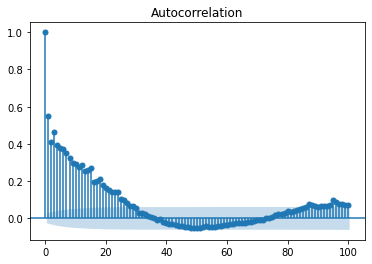

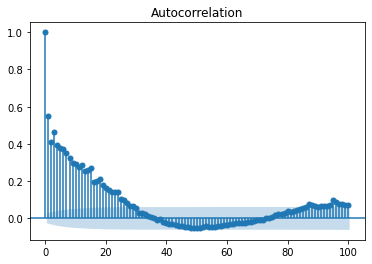

In [29]:
plot_acf(df['chinook0_wild_perhour'], lags = 100, missing = "conservative")

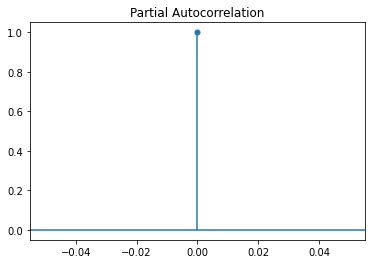

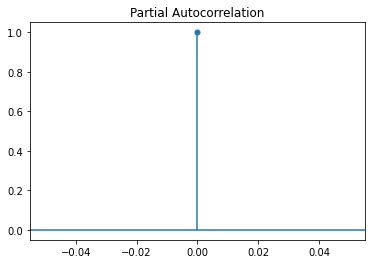

In [34]:
plot_pacf(df['chinook0_wild_perhour']) # I do not know what is goin on here. I will import dataset and work with R

In [39]:
df.to_csv(data_string + 'dungeness_all_days.csv', index=False)

In [6]:
dungeness_subset.to_csv(data_string + 'dungeness_subset.csv', index=False)